This notebook performs gene set enrichment analysis of an EcoTyper results dataset, using `eco_helper enrich`.

> **Note** <br>
> This notebook is auto-generated by `eco_helper`

## Input Section

This section defines the basic setup of the analysis. The subsequent cells can be run in bulk and need not necessarily be altered in any way.

### Variables to set
- config (optional)
  - The path to the Ecotyper config yaml file used for the experiments to summarize (if the same was used). The project folder can be specified as `{parent}`, the scripts folder within the parent can be specified as `{scripts}` if the config is not within either of these, and absolute path is required.
- directory
  - The name of the Ecotyper results directory. This needs to be either an absolute path or a subdirectory of the results directory within the project directory (parent directory). The results directory can be specified using `{results}`. 
- outdir 
  - The directory to save the outputs in.
- directory_is_absolute
  - Set this to *True* to mark the provided directory not as a subdirectory of the results directory but rather as a raw source directory containing eco_helper enrich results files.
- perform_enrichment (optional)
  - If no pathway enrichment has been performed yet, `eco_helper enrich` is called automatically irrespective of this variable. However, if enrichment has already been performed and data is found, this will force re-computation of the enrichment.

In [19]:
config = None
directory = "{results}/all_celltypes_30"
outdir = "{parent}/gsea_results/all_celltypes_30"

directory_is_absolute = False
perform_enrichment = False

The below variables are only required in case `eco_helper enrich` is called.

### Variables to set

- gene_sets
  - The gene sets to query.
- perform_enrichr
  - Set to False if `gseapy enrichr` should not be performed. This will also enable or disable loading of existing results.
- perform_prerank
  - Set to False if `prerank` should not be performed. This will also enable or disable loading of existing results.
- only_ecotype_contributing
  - Set to True to only perform gene set enrichment on celltypes and states that contribute to assigned Ecotypes.

In [20]:
gene_sets = ['Reactome_2016', 'WikiPathway_2021_Human', 'Panther_2016', 'KEGG_2021_Human', 'GO_Biological_Process_2021', 'GO_Molecular_Function_2021', 'GO_Cellular_Component_2021']

perform_enrichr = True
perform_prerank = False
only_ecotype_contributing = True

---
<br>

> This is an automated section for data processing. No need to alter anything in this section - if your project directory follows default structure and you specified everything properly in the config. 

Now import necessary packages

In [21]:
import eco_helper as eh
import eco_helper.enrich as enrich
import eco_helper.enrich.visualise as visualise

from qpcr._auxiliary.graphical import make_layout_from_list

import os, glob
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px 

# suppress annoying warnings
import warnings
warnings.filterwarnings( "ignore" )

pd.set_option('display.max_columns', 20)

Other project directories (need not necessarily be edited)

In [22]:
if not directory:
    raise ValueError( "Please specify a directory." )

# the parent directory of the EcoTyper project
user = os.environ.get( "USER" )
parent = "/data/users/{user}/EcoTyper".format( user = user )

# script and results directories within the parent
scripts = f"{parent}/scripts"
results = "{parent}/results".format( parent = parent )

enrichments_dir = "{parent}/gsea_enrichment".format( parent = parent, results = results )

outdir = outdir.format( parent = parent, results = results )
directory = directory.format( parent = parent, results = results )
data_dir = f"{enrichments_dir}/{ os.path.basename( directory ) }" if not directory_is_absolute else directory

if config:
    config = config.format( parent = parent, scripts = scripts )

Make sure we have a valid output directory and (re)-perform enrichment if necessary.

In [23]:
if not os.path.exists( outdir ):
    os.makedirs( outdir )

if not os.path.exists( enrichments_dir ):
    os.makedirs( enrichments_dir )

if perform_enrichment or not os.path.basename( directory ) in os.listdir( enrichments_dir ):
    
    print( "Calling eco_helper enrich")
    def run_enrich( with_enrichr, with_prerank, ecotypes_only ):
        """
        A small helper function to run eco_helper enrich
        """
        enrichr = "--enrichr" if with_enrichr else ""
        prerank = "--prerank" if with_prerank else ""
        ecotypes = "--ecotypes" if ecotypes_only else ""

        cmd = f"eco_helper enrich {enrichr} {prerank} \
                {ecotypes} \
                --assemble \
                --gene_sets { ' '.join( gene_sets ) } \
                --output {data_dir} \
                {directory}"

        os.system( cmd )
    
    run_enrich( with_enrichr = perform_enrichr, with_prerank = perform_prerank, ecotypes_only = only_ecotype_contributing )

Now load the enrichment results for all celltypes or ecotypes into two `EnrichmentCollections`, one for the `prerank` results (if available) and one for the `enrichr` results (if available).

In [24]:
resolution = "ecotype" if only_ecotype_contributing else "celltype"

prerank = None
if perform_prerank:
    prerank = eh.enrich.EnrichmentCollection( data_dir, resolution = resolution, which = "prerank" )

enrichr = None
if perform_enrichr:
    enrichr = eh.enrich.EnrichmentCollection( data_dir, resolution = resolution, which = "enrichr" )

---

## Analysis Section

From here on the user may perform their own analyses on the data.

Prepare some data columns

In [25]:
# apply log2 fold change for enrichment score and -log10 for FDR
for i in enrichr.keys():
    enrichr[ i ][ "log2_score" ] = np.log2( enrichr[ i ][ "Combined Score" ] ) 
    enrichr[ i ][ "log10_qval" ] = -np.log10( enrichr[ i ][ "Adjusted P-value" ] )

Set default plotting parameters

In [27]:
x = "log2_score"
y = "log10_qval"
hue = "CellType"
style = None
xlabels = {  "matplotlib" : "$log_2$ Combined Score", 
             "plotly" : "log_2 Combined Score" }
ylabels = {  "matplotlib" : "$-log_{10}$ q-value", 
             "plotly" : "-log_10 q-value" }

# automatically get the right labels for the respective backends
xlabel = lambda : xlabels[ visualise.backend ]
ylabel = lambda : ylabels[ visualise.backend ]

sns.set_style( "ticks" )
sns.set_palette( "husl" )


> **Note**<br>
> The following code is auto-generated by `eco_helper`

# Enrichment results for ecotypes (enrichr)

In [28]:
# a function to get cell-type specific dataframes from the collection

def get_celltype_df( ecotype, celltype ):
    max_length = 60 # just to make sure the gene names are not too long
    df = enrichr[ ecotype ].query( f"CellType == '{celltype}'" )
    df[ "Genes" ] = df[ "Genes" ].apply( lambda x : x.replace( ";" , " " ) )
    df.loc[ :, "Genes" ] = df[ "Genes" ].apply( lambda x : x[:max_length]+"..." if len(x) > max_length else x )
    return df

Interactive collection summary

In [29]:
visualise.backend = "plotly"
fig = visualise.collection_scatterplot( collection = enrichr, 
                                        x = x, 
                                        y = y, 
                                        hue = hue, 
                                        style = style, 
                                        xlabel = xlabel(),
                                        ylabel = ylabel(),
                                    )

fig.write_html( f"{outdir}/enrichr_summary.html" )
fig.show()

Static collection summary

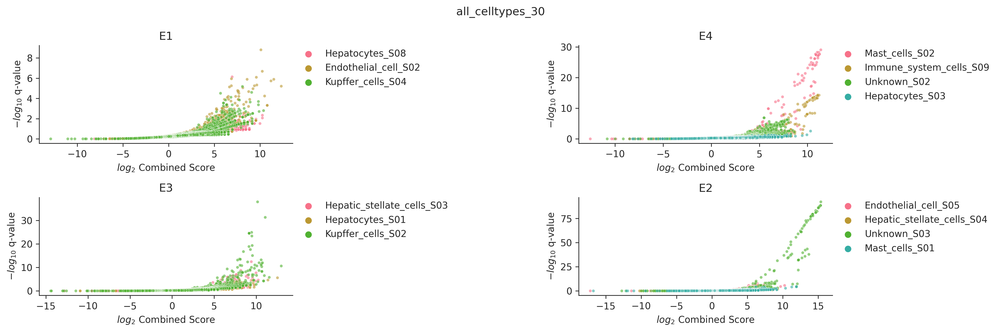

In [11]:
visualise.backend = "matplotlib"
fig = visualise.collection_scatterplot( collection = enrichr, 
                                        x = x, 
                                        y = y, 
                                        hue = hue, 
                                        style = style,
                                        xlabel = xlabel(),   
                                        ylabel = ylabel(),
                                        figsize = (15, 5),
                                        alpha = 0.6,
                                        s = 10,
                                    )

fig.suptitle( os.path.basename( directory ) )
sns.despine()
plt.tight_layout( w_pad = 10 )

plt.savefig( f"{outdir}/enrichr_summary.png" )

## E1 

-----------------

### Endothelial_cell_S02

In [12]:
endothelial_cell_s02_df = get_celltype_df( "E1", "Endothelial_cell_S02" )
endothelial_cell_s02_scatter = visualise.StateScatterplot( df = endothelial_cell_s02_df, x = x, y = y, hue = hue, style = style )

Categories to highlight in Endothelial_cell_S02

In [13]:
categories = {
	"heat associated" : ["thermo", "heat", "thermal", "heat( |-|_)shock", "HS(F|P)"],
	"protein (mis-)folding related (including chaperones)" : ["unfolded( |-|_)?protein", "chaperone", "incorrect protein", "protein( |-|_)?folding"],
	"Interferon" : ["interferon", "IFN"],
	"MAPK" : ["MAPK"],
	"DNA damage" : ["DNA( |-|_)damage", "DNA( |-|_)repair"],
	"stress response" : ["response to stress", "stress response", "stress"],
	"inclusion bodies" : ["inclusion( |-|_)?bod(y|ies)"],
	"RNA metabolism" : ["m?RNA", "transcription", "NMD", "nonsense ?-?mediated"]
	}

Interactive scatterplot

In [14]:
visualise.backend = "plotly"
fig = endothelial_cell_s02_scatter.highlight(  

    ref_col = "Term", subsets = categories, 
    xlabel = xlabel(), ylabel = ylabel(),
    title = "E1 Endothelial_cell_S02",
    hover_data = { "Combined Score" : "Combined Score", "Genes": "Genes" },

)
fig.show()

In [15]:
fig.write_html( f"{outdir}/E1_Endothelial_cell_S02.html" )

Static scatterplot

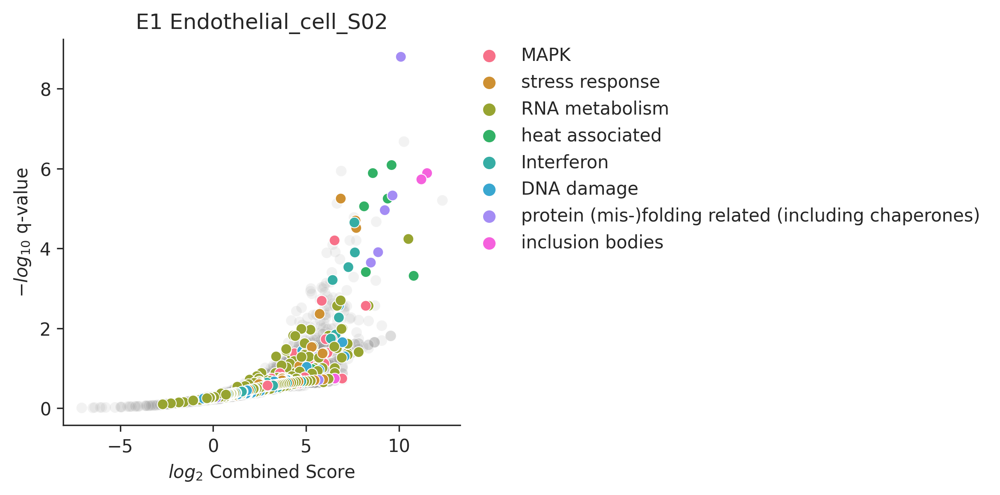

In [16]:
visualise.backend = "matplotlib"
fig = endothelial_cell_s02_scatter.highlight(  

    ref_col = "Term", subsets = categories, 
    xlabel = xlabel(), ylabel = ylabel(),
    title = "E1 Endothelial_cell_S02",

)
sns.despine()
plt.savefig( f"{outdir}/E1_Endothelial_cell_S02.png", bbox_inches = "tight", facecolor = None )

### Hepatocytes_S08

In [17]:
hepatocytes_s08_df = get_celltype_df( "E1", "Hepatocytes_S08" )
hepatocytes_s08_scatter = visualise.StateScatterplot( df = hepatocytes_s08_df, x = x, y = y, hue = hue, style = style )

Categories to highlight in Hepatocytes_S08

In [18]:
categories = {
	"lipid associated" : ["lipid", "lipo(protein)?", "triacyl", "lipase", "acylglycer", "triglycer", "chylomicron", "fat", "fatty ?-?_?acid", "L( |_|-)?DL", "H( |_|-)?DL", "V( |_|-)?LDL", "PPAR"],
	"steroid / cholesterol" : ["steroid", "cholesterol"],
	"sugar associated" : ["ose", "glyco", "sugar"],
	"(transmembrane) transport" : ["transmembrane", "transmembrane ?-?transport", "transporter", "channel"],
	"aldehyde lyase" : ["aldehyde( |-|_)lyase"],
	"amino acids" : ["valine", "leucine", "isoleucine", "methionine", "glutamine", "glutamate", "asparagine", "aspartate", "proline", "lysine", "tryptophane", "tyrosine", "arginine", "histidine", "serine", "glycine", "alanine", "threonine", "cysteine", "phenylalanine", "amino-?_?acid"]
	}

Interactive scatterplot

In [19]:
visualise.backend = "plotly"
fig = hepatocytes_s08_scatter.highlight(  

    ref_col = "Term", subsets = categories, 
    xlabel = xlabel(), ylabel = ylabel(),
    title = "E1 Hepatocytes_S08",
    hover_data = { "Combined Score" : "Combined Score", "Genes": "Genes" },

)
fig.show()

In [20]:
fig.write_html( f"{outdir}/E1_Hepatocytes_S08.html" )

Static scatterplot

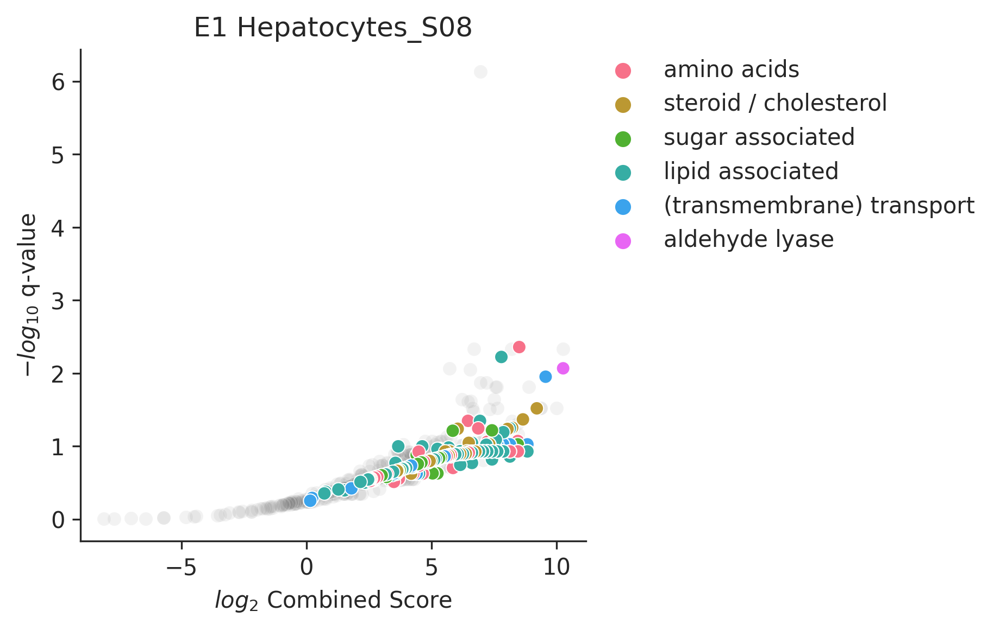

In [21]:
visualise.backend = "matplotlib"
fig = hepatocytes_s08_scatter.highlight(  

    ref_col = "Term", subsets = categories, 
    xlabel = xlabel(), ylabel = ylabel(),
    title = "E1 Hepatocytes_S08",

)
sns.despine()
plt.savefig( f"{outdir}/E1_Hepatocytes_S08.png", bbox_inches = "tight", facecolor = None )

### Kupffer_cells_S04

In [31]:
kupffer_cells_s04_df = get_celltype_df( "E1", "Kupffer_cells_S04" )
kupffer_cells_s04_scatter = visualise.StateScatterplot( df = kupffer_cells_s04_df, x = x, y = y, hue = hue, style = style )

Categories to highlight in Kupffer_cells_S04

In [32]:
categories = {
	"lipid associated" : ["lipid", "lipo(protein)?", "triacyl", "lipase", "acylglycer", "triglycer", "chylomicron", "fat", "fatty ?-?_?acid", "L( |_|-)?DL", "H( |_|-)?DL", "V( |_|-)?LDL", "PPAR"],
	"steroid / cholesterol" : ["steroid", "cholesterol"],
	"sugar associated" : ["ose", "glyco", "sugar"],
	"Amyloid-beta related" : ["amyloid( |-|_)beta"],
	
	"cytokine / chemokine related" : ["cytokine", "chemokine"],
	"Interleukin" : ["interleukin", "IL- "],
	"Interferon" : ["interferon", "IFN"],
	"immunity / complement / inflammation" : ["immune response", "immune", "immunity", "inflamma", "complement", "B-? ?cell", "T-? ?cell", "lymphocyte", "lymph(atic|oid) cell"],
	"RNA metabolism" : ["m?RNA", "transcription", "NMD", "nonsense ?-?mediated"],
	"amino acids" : ["valine", "leucine", "isoleucine", "methionine", "glutamine", "glutamate", "asparagine", "aspartate", "proline", "lysine", "tryptophane", "tyrosine", "arginine", "histidine", "serine", "glycine", "alanine", "threonine", "cysteine", "phenylalanine", "amino-?_?acid"]
	}

Interactive scatterplot

In [33]:
visualise.backend = "plotly"
fig = kupffer_cells_s04_scatter.highlight(  

    ref_col = "Term", subsets = categories, 
    xlabel = xlabel(), ylabel = ylabel(),
    title = "E1 Kupffer_cells_S04",
    hover_data = { "Combined Score" : "Combined Score", "Genes": "Genes" },

)
fig.show()

In [25]:
fig.write_html( f"{outdir}/E1_Kupffer_cells_S04.html" )

Static scatterplot

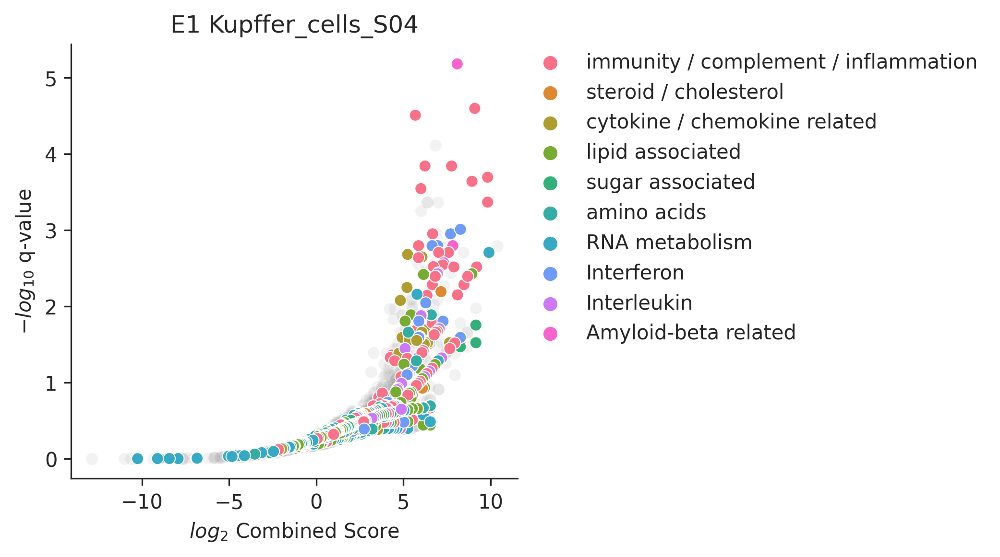

In [26]:
visualise.backend = "matplotlib"
fig = kupffer_cells_s04_scatter.highlight(  

    ref_col = "Term", subsets = categories, 
    xlabel = xlabel(), ylabel = ylabel(),
    title = "E1 Kupffer_cells_S04",

)
sns.despine()
plt.savefig( f"{outdir}/E1_Kupffer_cells_S04.png", bbox_inches = "tight", facecolor = None )

## E4 

-----------------

### Hepatocytes_S03

In [10]:
hepatocytes_s03_df = get_celltype_df( "E4", "Hepatocytes_S03" )
hepatocytes_s03_scatter = visualise.StateScatterplot( df = hepatocytes_s03_df, x = x, y = y, hue = hue, style = style )

Categories to highlight in Hepatocytes_S03

In [13]:
categories = {
	"lipid associated" : ["lipid", "lipo(protein)?", "triacyl", "lipase", "acylglycer", "triglycer", "chylomicron", "fat", "fatty ?-?_?acid", "L( |_|-)?DL", "H( |_|-)?DL", "V( |_|-)?LDL", "PPAR"],
	# "sugar associated" : ["ose", "glyco", "sugar"],
	"FGF related" : ["FGF", "fibroblast( |-|_)growth( |-|_)factor"],
	"blood related" : ["blood", "vascular", "vaso", "angio"],
	# "cell structures" : ["actin", "fibr", "cyto ?-?skelet", "envel", "tubulin"],
	# "RNA metabolism" : ["m?RNA", "transcription", "NMD", "nonsense ?-?mediated"],
	"ILG related" : ["ILG", "insulin( |-|_)like( |-|_)growth( |-|_)factor"],
	"Tyrosine kinase" : ["tyrosine( |-|_)kinase", "PTK", "RTK"],
	# "amino acids" : ["valine", "leucine", "isoleucine", "methionine", "glutamine", "glutamate", "asparagine", "aspartate", "proline", "lysine", "tryptophane", "tyrosine", "arginine", "histidine", "serine", "glycine", "alanine", "threonine", "cysteine", "phenylalanine", "amino-?_?acid"]
	}

Interactive scatterplot

In [14]:
visualise.backend = "plotly"
fig = hepatocytes_s03_scatter.highlight(  

    ref_col = "Term", subsets = categories, 
    xlabel = xlabel(), ylabel = ylabel(),
    title = "E4 Hepatocytes_S03",
    hover_data = { "Combined Score" : "Combined Score", "Genes": "Genes" },

)
fig.show()

In [15]:
fig.write_html( f"{outdir}/E4_Hepatocytes_S03.html" )

Static scatterplot

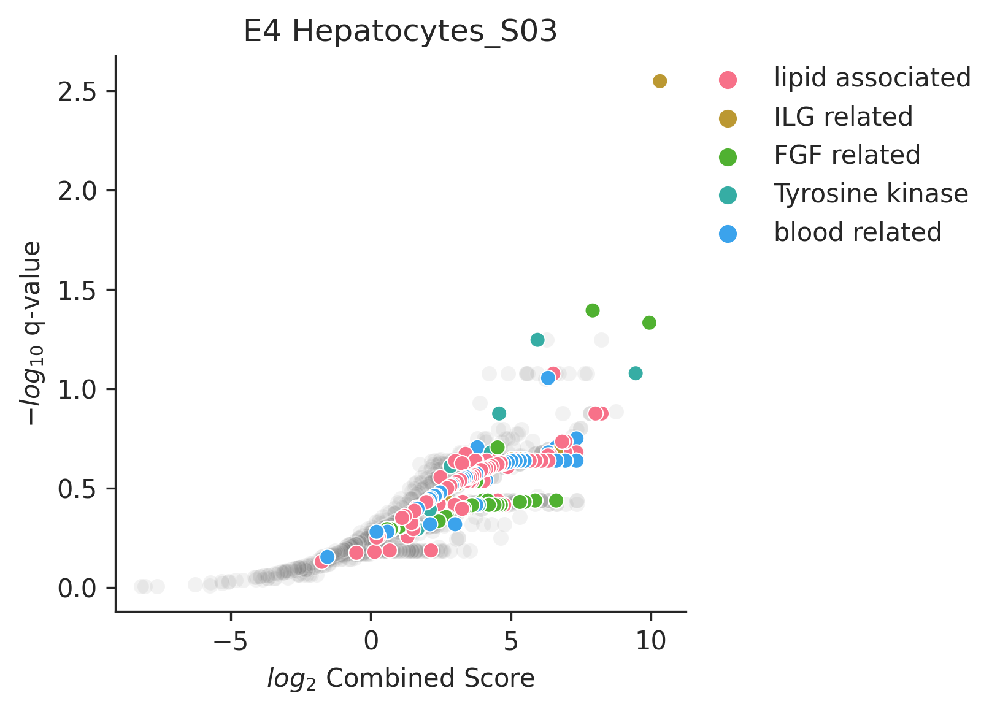

In [16]:
visualise.backend = "matplotlib"
fig = hepatocytes_s03_scatter.highlight(  

    ref_col = "Term", subsets = categories, 
    xlabel = xlabel(), ylabel = ylabel(),
    title = "E4 Hepatocytes_S03",

)
sns.despine()
plt.savefig( f"{outdir}/E4_Hepatocytes_S03.png", bbox_inches = "tight", facecolor = None )

### Immune_system_cells_S09

In [17]:
immune_system_cells_s09_df = get_celltype_df( "E4", "Immune_system_cells_S09" )
immune_system_cells_s09_scatter = visualise.StateScatterplot( df = immune_system_cells_s09_df, x = x, y = y, hue = hue, style = style )

Categories to highlight in Immune_system_cells_S09

In [20]:
categories = {
	"Interleukin" : ["interleukin", "IL- "],
	# "immunity / complement / inflammation" : ["immune response", "immune", "immunity", "inflamma", "complement", "B-? ?cell", "T-? ?cell", "lymphocyte", "lymph(atic|oid) cell"],
	"translation" : ["translation", "rRNA", "ribosom", "peptide chain", "elongation", "initiation", "termination"],
	"RNA metabolism" : ["m?RNA", "transcription", "NMD", "nonsense ?-?mediated"],
	# "amino acids" : ["valine", "leucine", "isoleucine", "methionine", "glutamine", "glutamate", "asparagine", "aspartate", "proline", "lysine", "tryptophane", "tyrosine", "arginine", "histidine", "serine", "glycine", "alanine", "threonine", "cysteine", "phenylalanine", "amino-?_?acid"]
	}

Interactive scatterplot

In [21]:
visualise.backend = "plotly"
fig = immune_system_cells_s09_scatter.highlight(  

    ref_col = "Term", subsets = categories, 
    xlabel = xlabel(), ylabel = ylabel(),
    title = "E4 Immune_system_cells_S09",
    hover_data = { "Combined Score" : "Combined Score", "Genes": "Genes" },

)
fig.show()

In [22]:
fig.write_html( f"{outdir}/E4_Immune_system_cells_S09.html" )

Static scatterplot

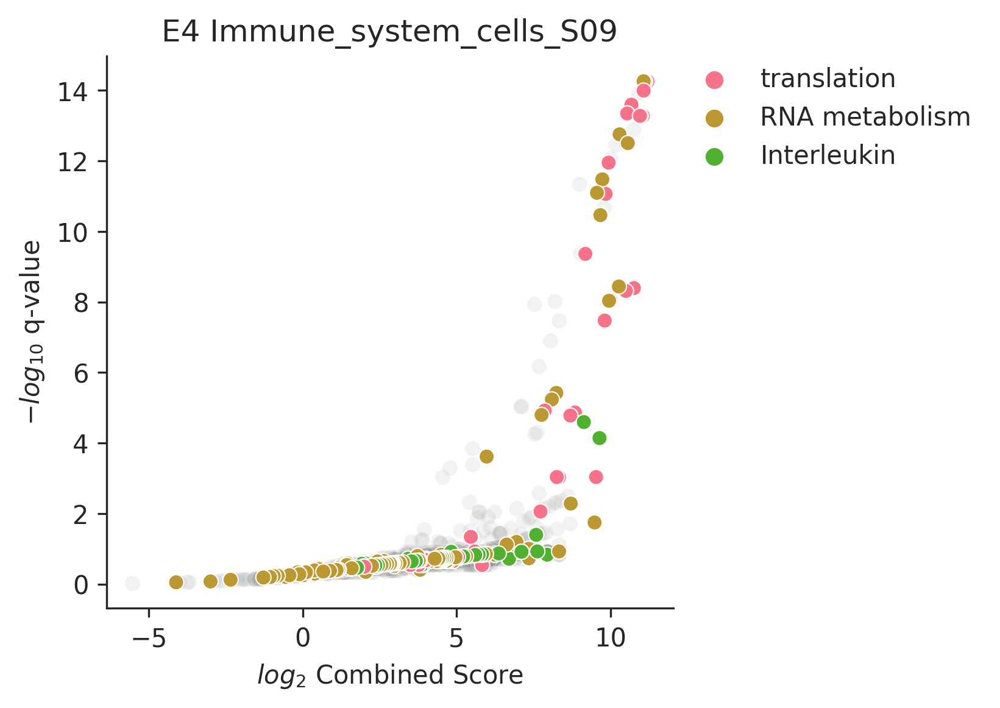

In [23]:
visualise.backend = "matplotlib"
fig = immune_system_cells_s09_scatter.highlight(  

    ref_col = "Term", subsets = categories, 
    xlabel = xlabel(), ylabel = ylabel(),
    title = "E4 Immune_system_cells_S09",

)
sns.despine()
plt.savefig( f"{outdir}/E4_Immune_system_cells_S09.png", bbox_inches = "tight", facecolor = None )

### Mast_cells_S02

In [24]:
mast_cells_s02_df = get_celltype_df( "E4", "Mast_cells_S02" )
mast_cells_s02_scatter = visualise.StateScatterplot( df = mast_cells_s02_df, x = x, y = y, hue = hue, style = style )

Categories to highlight in Mast_cells_S02

In [25]:
categories = {
	# "cytokine / chemokine related" : ["cytokine", "chemokine"],
	"Interleukin" : ["interleukin", "IL- "],
	# "Apoptosis" : ["apoptosis", "apopto"],
	# "Membrane associated" : ["membrane"],
	"Cell surface" : ["cell ?-?surface", "cell ?-?periphery", "cell ?-?membrane", "cell ?-?junction", "plasma ?-?membrane", "integrin", "adhesion", "cell-cell", "cadherin"],
	# "immunity / complement / inflammation" : ["immune response", "immune", "immunity", "inflamma", "complement", "B-? ?cell", "T-? ?cell", "lymphocyte", "lymph(atic|oid) cell"],
	"translation" : ["translation", "rRNA", "ribosom", "peptide chain", "elongation", "initiation", "termination"],
	"RNA metabolism" : ["m?RNA", "transcription", "NMD", "nonsense ?-?mediated"],
	"amino acids" : ["valine", "leucine", "isoleucine", "methionine", "glutamine", "glutamate", "asparagine", "aspartate", "proline", "lysine", "tryptophane", "tyrosine", "arginine", "histidine", "serine", "glycine", "alanine", "threonine", "cysteine", "phenylalanine", "amino-?_?acid"]
	}

Interactive scatterplot

In [26]:
visualise.backend = "plotly"
fig = mast_cells_s02_scatter.highlight(  

    ref_col = "Term", subsets = categories, 
    xlabel = xlabel(), ylabel = ylabel(),
    title = "E4 Mast_cells_S02",
    hover_data = { "Combined Score" : "Combined Score", "Genes": "Genes" },

)
fig.show()

In [27]:
fig.write_html( f"{outdir}/E4_Mast_cells_S02.html" )

Static scatterplot

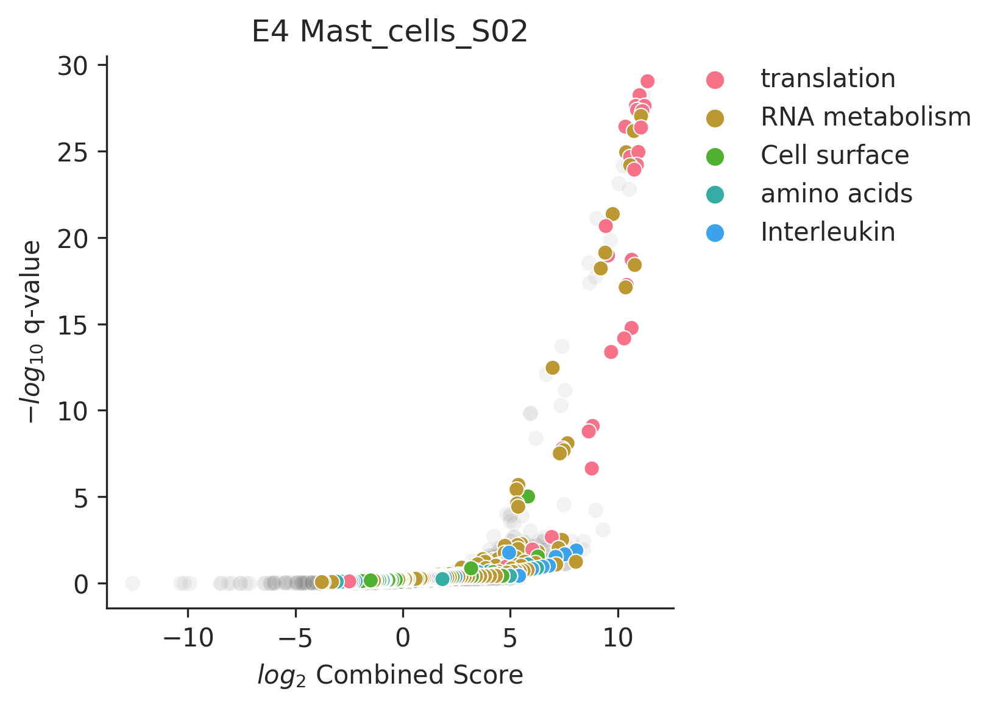

In [28]:
visualise.backend = "matplotlib"
fig = mast_cells_s02_scatter.highlight(  

    ref_col = "Term", subsets = categories, 
    xlabel = xlabel(), ylabel = ylabel(),
    title = "E4 Mast_cells_S02",

)
sns.despine()
plt.savefig( f"{outdir}/E4_Mast_cells_S02.png", bbox_inches = "tight", facecolor = None )

### Unknown_S02

In [29]:
unknown_s02_df = get_celltype_df( "E4", "Unknown_S02" )
unknown_s02_scatter = visualise.StateScatterplot( df = unknown_s02_df, x = x, y = y, hue = hue, style = style )

Categories to highlight in Unknown_S02

In [30]:
categories = {
	"lipid associated" : ["lipid", "lipo(protein)?", "triacyl", "lipase", "acylglycer", "triglycer", "chylomicron", "fat", "fatty ?-?_?acid", "L( |_|-)?DL", "H( |_|-)?DL", "V( |_|-)?LDL", "PPAR"],
	"cytokine / chemokine related" : ["cytokine", "chemokine"],
	"Interleukin" : ["interleukin", "IL- "],
	"Apoptosis" : ["apoptosis", "apopto"],
	# "blood related" : ["blood", "vascular", "vaso"],
	# "Membrane associated" : ["membrane"],
	"Cell surface" : ["cell ?-?surface", "cell ?-?periphery", "cell ?-?membrane", "cell ?-?junction", "plasma ?-?membrane", "integrin", "adhesion", "cell-cell", "cadherin"],
	"cell structures" : ["actin", "fibr", "cyto ?-?skelet", "envel", "tubulin"],
	# "(transmembrane) transport" : ["transmembrane", "transmembrane ?-?transport", "transporter", "channel"],
	"immunity / complement / inflammation" : ["immune response", "immune", "immunity", "inflamma", "complement", "B-? ?cell", "T-? ?cell", "lymphocyte", "lymph(atic|oid) cell"],
	"translation" : ["translation", "rRNA", "ribosom", "peptide chain", "elongation", "initiation", "termination"],
	"RNA metabolism" : ["m?RNA", "transcription", "NMD", "nonsense ?-?mediated"],
	"amino acids" : ["valine", "leucine", "isoleucine", "methionine", "glutamine", "glutamate", "asparagine", "aspartate", "proline", "lysine", "tryptophane", "tyrosine", "arginine", "histidine", "serine", "glycine", "alanine", "threonine", "cysteine", "phenylalanine", "amino-?_?acid"]
	}

Interactive scatterplot

In [31]:
visualise.backend = "plotly"
fig = unknown_s02_scatter.highlight(  

    ref_col = "Term", subsets = categories, 
    xlabel = xlabel(), ylabel = ylabel(),
    title = "E4 Unknown_S02",
    hover_data = { "Combined Score" : "Combined Score", "Genes": "Genes" },

)
fig.show()

In [32]:
fig.write_html( f"{outdir}/E4_Unknown_S02.html" )

Static scatterplot

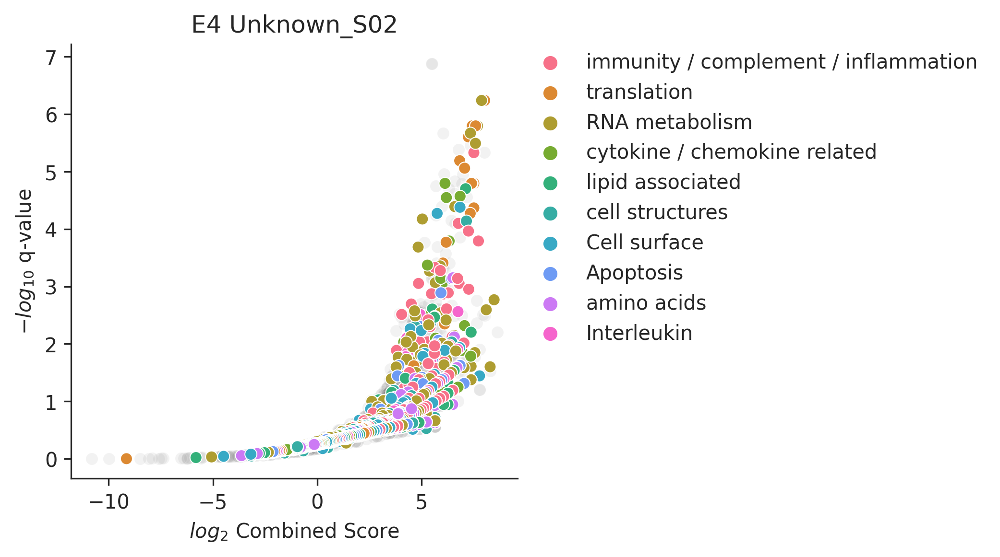

In [33]:
visualise.backend = "matplotlib"
fig = unknown_s02_scatter.highlight(  

    ref_col = "Term", subsets = categories, 
    xlabel = xlabel(), ylabel = ylabel(),
    title = "E4 Unknown_S02",

)
sns.despine()
plt.savefig( f"{outdir}/E4_Unknown_S02.png", bbox_inches = "tight", facecolor = None )

## E3 

-----------------

### Hepatic_stellate_cells_S03

In [34]:
hepatic_stellate_cells_s03_df = get_celltype_df( "E3", "Hepatic_stellate_cells_S03" )
hepatic_stellate_cells_s03_scatter = visualise.StateScatterplot( df = hepatic_stellate_cells_s03_df, x = x, y = y, hue = hue, style = style )

Categories to highlight in Hepatic_stellate_cells_S03

In [37]:
categories = {
	"blood related" : ["blood", "vascular", "vaso"],
	# "Membrane associated" : ["membrane"],
	"Muscle related" : ["muscle", "sarcoplasmic"],
	"Rho-GTPases" : ["rho( |-|_)"],
	
	"Cell surface" : ["cell ?-?surface", "cell ?-?periphery", "cell ?-?membrane", "cell ?-?junction", "plasma ?-?membrane", "integrin", "adhesion", "cell-cell", "cadherin"],
	"cell structures" : ["actin", "fibr", "cyto ?-?skelet", "envel", "tubulin"],
	# "(transmembrane) transport" : ["transmembrane", "transmembrane ?-?transport", "transporter", "channel"],
	# "RNA metabolism" : ["m?RNA", "transcription", "NMD", "nonsense ?-?mediated"]
	}

Interactive scatterplot

In [38]:
visualise.backend = "plotly"
fig = hepatic_stellate_cells_s03_scatter.highlight(  

    ref_col = "Term", subsets = categories, 
    xlabel = xlabel(), ylabel = ylabel(),
    title = "E3 Hepatic_stellate_cells_S03",
    hover_data = { "Combined Score" : "Combined Score", "Genes": "Genes" },

)
fig.show()

In [39]:
fig.write_html( f"{outdir}/E3_Hepatic_stellate_cells_S03.html" )

Static scatterplot

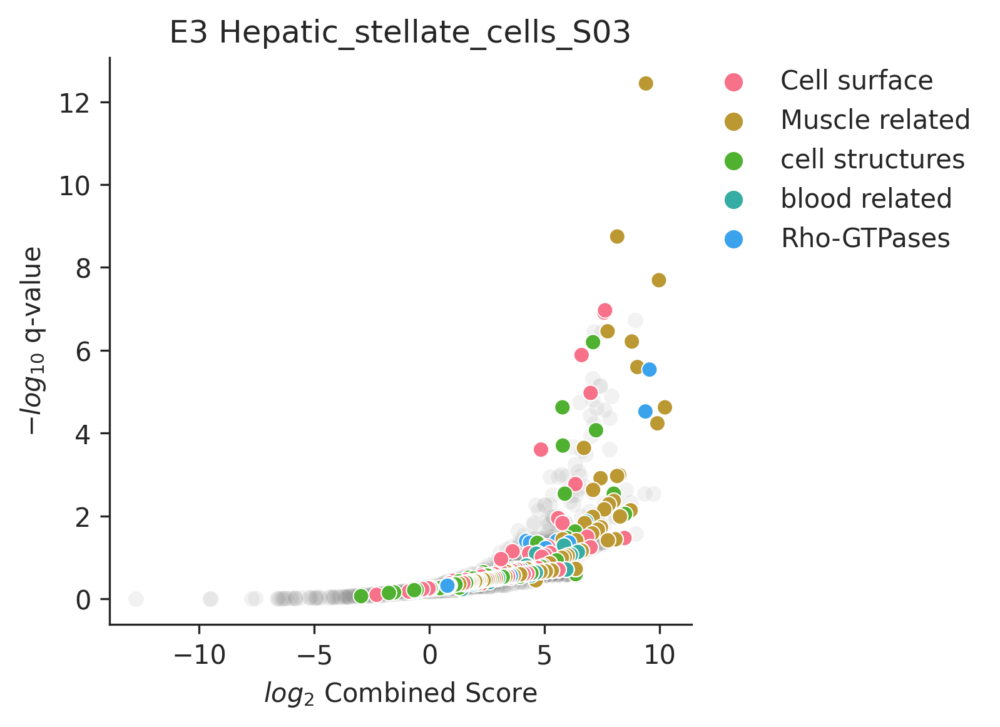

In [40]:
visualise.backend = "matplotlib"
fig = hepatic_stellate_cells_s03_scatter.highlight(  

    ref_col = "Term", subsets = categories, 
    xlabel = xlabel(), ylabel = ylabel(),
    title = "E3 Hepatic_stellate_cells_S03",

)
sns.despine()
plt.savefig( f"{outdir}/E3_Hepatic_stellate_cells_S03.png", bbox_inches = "tight", facecolor = None )

### Hepatocytes_S01

In [41]:
hepatocytes_s01_df = get_celltype_df( "E3", "Hepatocytes_S01" )
hepatocytes_s01_scatter = visualise.StateScatterplot( df = hepatocytes_s01_df, x = x, y = y, hue = hue, style = style )

Categories to highlight in Hepatocytes_S01

In [48]:
categories = {
	# "lipid associated" : ["lipid", "lipo(protein)?", "triacyl", "lipase", "acylglycer", "triglycer", "chylomicron", "fat", "fatty ?-?_?acid", "L( |_|-)?DL", "H( |_|-)?DL", "V( |_|-)?LDL", "PPAR"],
	# "sugar associated" : ["ose", "glyco", "sugar"],
	"Cell surface / Extracellular Matrix" : ["extracellular", "cell ?-?surface", "cell ?-?periphery", "cell ?-?membrane", "cell ?-?junction", "plasma ?-?membrane", "integrin", "adhesion", "cell-cell", "cadherin"],
	# "(transmembrane) transport" : ["transmembrane", "transmembrane ?-?transport", "transporter", "channel"],
	"immunity / complement / inflammation" : ["membrane attack", "immune response", "immune", "immunity", "inflamma", "complement", "B-? ?cell", "T-? ?cell", "lymphocyte", "lymph(atic|oid) cell"],
	"Endopeptidase" : ["Endopeptidase"],
	# "amino acids" : ["valine", "leucine", "isoleucine", "methionine", "glutamine", "glutamate", "asparagine", "aspartate", "proline", "lysine", "tryptophane", "tyrosine", "arginine", "histidine", "serine", "glycine", "alanine", "threonine", "cysteine", "phenylalanine", "amino-?_?acid"]
	}

Interactive scatterplot

In [49]:
visualise.backend = "plotly"
fig = hepatocytes_s01_scatter.highlight(  

    ref_col = "Term", subsets = categories, 
    xlabel = xlabel(), ylabel = ylabel(),
    title = "E3 Hepatocytes_S01",
    hover_data = { "Combined Score" : "Combined Score", "Genes": "Genes" },

)
fig.show()

In [50]:
fig.write_html( f"{outdir}/E3_Hepatocytes_S01.html" )

Static scatterplot

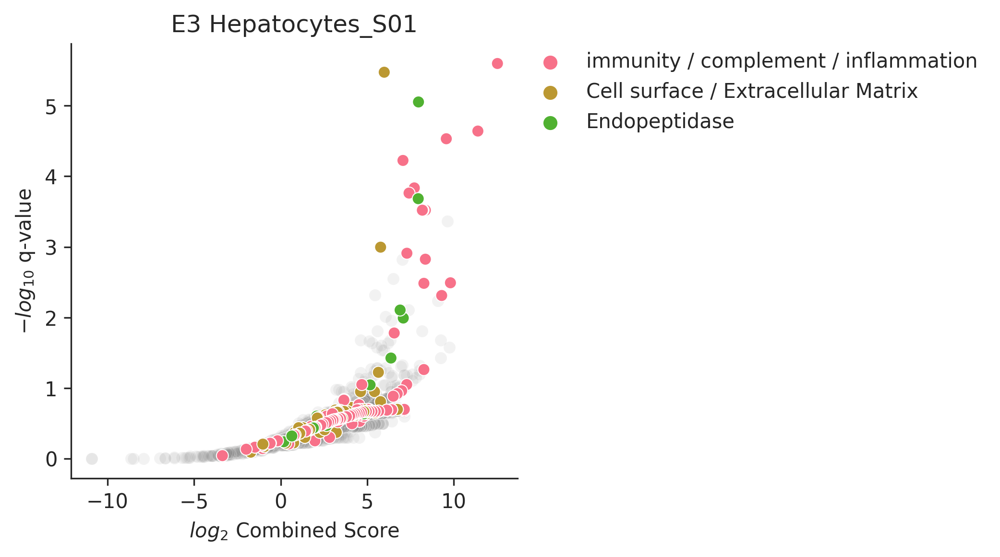

In [51]:
visualise.backend = "matplotlib"
fig = hepatocytes_s01_scatter.highlight(  

    ref_col = "Term", subsets = categories, 
    xlabel = xlabel(), ylabel = ylabel(),
    title = "E3 Hepatocytes_S01",

)
sns.despine()
plt.savefig( f"{outdir}/E3_Hepatocytes_S01.png", bbox_inches = "tight", facecolor = None )

### Kupffer_cells_S02

In [52]:
kupffer_cells_s02_df = get_celltype_df( "E3", "Kupffer_cells_S02" )
kupffer_cells_s02_scatter = visualise.StateScatterplot( df = kupffer_cells_s02_df, x = x, y = y, hue = hue, style = style )

Categories to highlight in Kupffer_cells_S02

In [65]:
categories = {
	"lipid associated" : ["lipid", "lipo(protein)?", "triacyl", "lipase", "acylglycer", "triglycer", "chylomicron", "fat", "fatty ?-?_?acid", "L( |_|-)?DL", "H( |_|-)?DL", "V( |_|-)?LDL", "PPAR"],
	"sugar associated" : ["ose", "glyco", "sugar"],
	# "Interleukin" : ["interleukin", "IL- "],
	"Lysosome / Phagosome / granule associated" : ["lysosom", "lytic", "granule", "vacuol", "phagosome"],
	# "Cell surface" : ["cell ?-?surface", "cell ?-?periphery", "cell ?-?membrane", "cell ?-?junction", "plasma ?-?membrane", "integrin", "adhesion", "cell-cell", "cadherin"],
	# "cell structures" : ["actin", "fibr", "cyto ?-?skelet", "envel", "tubulin"],
	"(transmembrane) transport" : ["transmembrane", "transmembrane ?-?transport", "transporter", "channel"],
	# "immunity / complement / inflammation" : ["immune response", "immune", "immunity", "inflamma", "complement", "B-? ?cell", "T-? ?cell", "lymphocyte", "lymph(atic|oid) cell"]
	}

Interactive scatterplot

In [66]:
visualise.backend = "plotly"
fig = kupffer_cells_s02_scatter.highlight(  

    ref_col = "Term", subsets = categories, 
    xlabel = xlabel(), ylabel = ylabel(),
    title = "E3 Kupffer_cells_S02",
    hover_data = { "Combined Score" : "Combined Score", "Genes": "Genes" },

)
fig.show()

In [67]:
fig.write_html( f"{outdir}/E3_Kupffer_cells_S02.html" )

Static scatterplot

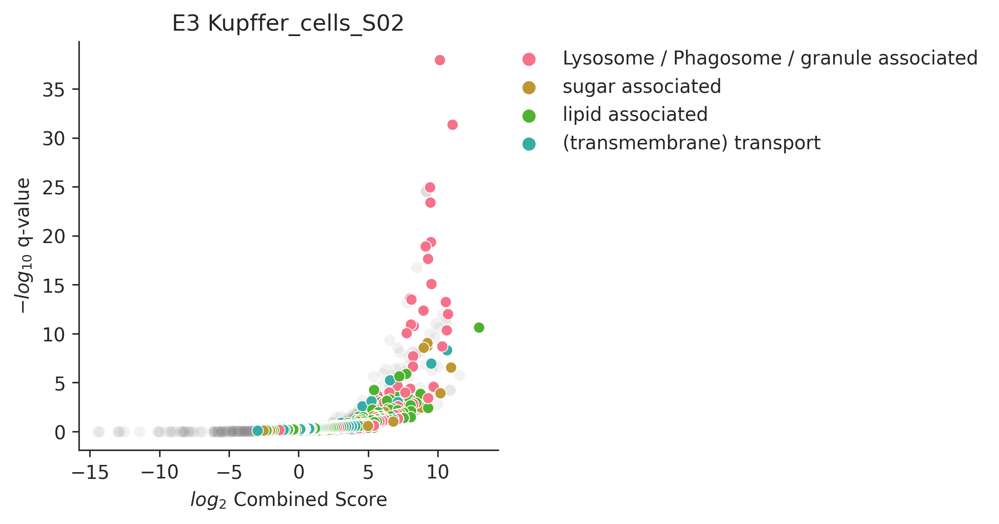

In [68]:
visualise.backend = "matplotlib"
fig = kupffer_cells_s02_scatter.highlight(  

    ref_col = "Term", subsets = categories, 
    xlabel = xlabel(), ylabel = ylabel(),
    title = "E3 Kupffer_cells_S02",

)
sns.despine()
plt.savefig( f"{outdir}/E3_Kupffer_cells_S02.png", bbox_inches = "tight", facecolor = None )

## E2 

-----------------

### Endothelial_cell_S05

In [69]:
endothelial_cell_s05_df = get_celltype_df( "E2", "Endothelial_cell_S05" )
endothelial_cell_s05_scatter = visualise.StateScatterplot( df = endothelial_cell_s05_df, x = x, y = y, hue = hue, style = style )

Categories to highlight in Endothelial_cell_S05

In [84]:
categories = {
	# "lipid associated" : ["lipid", "lipo(protein)?", "triacyl", "lipase", "acylglycer", "triglycer", "chylomicron", "fat", "fatty ?-?_?acid", "L( |_|-)?DL", "H( |_|-)?DL", "V( |_|-)?LDL", "PPAR"],
	# "VEGF associated" : ["VEGF", "vascular( |-|_)?endothelial( |-|_)?growth"],
	"Signalling pathways" : ["signall?ing", "signal"],
	"Apoptosis" : ["apoptosis", "apopto"],
	# "blood related" : ["blood", "vascular", "vaso"],
	"Oxphos / TCA" : ["NADH", "oxidative ?-?phospho", "respiratory ?-?chain", "oxphos", "electron ?-?_?transport", "electron ?-?_?transport ?-?_?chain", "TCA", "citric ?-?acid ?-?cycle", "krebs ?-?cycle", "cytochrome", "mitochondrial ?-?(inner)? ?-?membrane", "proton transmembrane", "Complex-? ?(I|II|III|IV|V)", "oxidoreduction"],
	# "Membrane associated" : ["membrane"],
	"Cell surface" : ["junctions?", "cell ?-?surface", "cell ?-?periphery", "cell ?-?membrane", "cell ?-?junction", "plasma ?-?membrane", "integrin", "adhesion", "cell-cell", "cadherin"],
	"cell structures" : ["actin", "fibr", "cyto ?-?skelet", "envel", "tubulin"],
	"cell cycle" : ["cyclin", "CDK", "cell ?-?cycle"],
	# "RNA metabolism" : ["m?RNA", "transcription", "NMD", "nonsense ?-?mediated"],
	# "amino acids" : ["valine", "leucine", "isoleucine", "methionine", "glutamine", "glutamate", "asparagine", "aspartate", "proline", "lysine", "tryptophane", "tyrosine", "arginine", "histidine", "serine", "glycine", "alanine", "threonine", "cysteine", "phenylalanine", "amino-?_?acid"]
	}

Interactive scatterplot

In [85]:
visualise.backend = "plotly"
fig = endothelial_cell_s05_scatter.highlight(  

    ref_col = "Term", subsets = categories, 
    xlabel = xlabel(), ylabel = ylabel(),
    title = "E2 Endothelial_cell_S05",
    hover_data = { "Combined Score" : "Combined Score", "Genes": "Genes" },

)
fig.show()

In [82]:
fig.write_html( f"{outdir}/E2_Endothelial_cell_S05.html" )

Static scatterplot

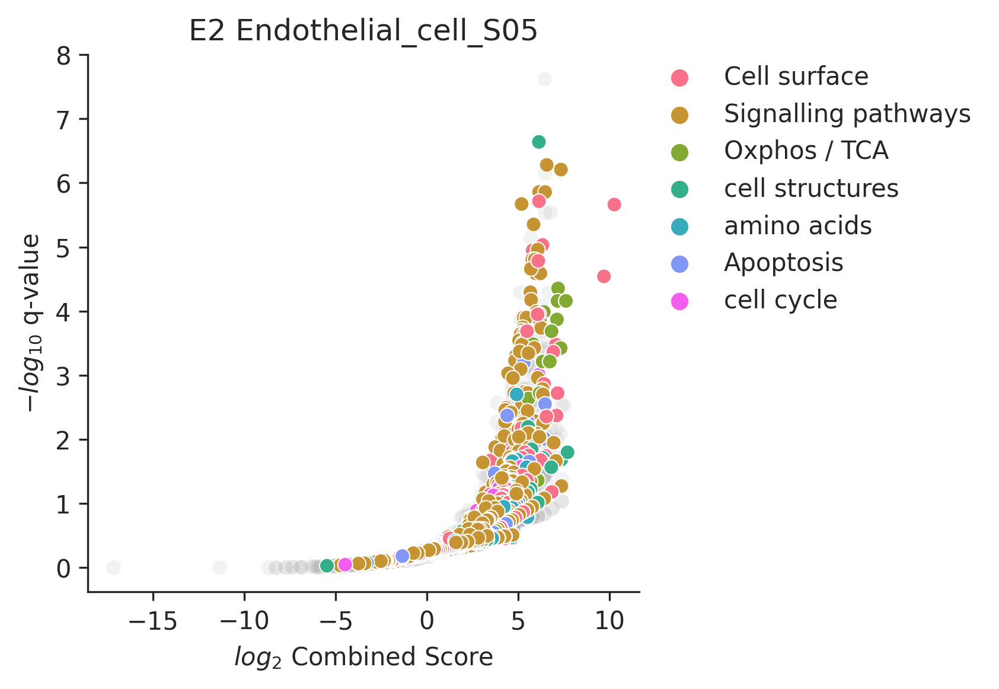

In [83]:
visualise.backend = "matplotlib"
fig = endothelial_cell_s05_scatter.highlight(  

    ref_col = "Term", subsets = categories, 
    xlabel = xlabel(), ylabel = ylabel(),
    title = "E2 Endothelial_cell_S05",

)
sns.despine()
plt.savefig( f"{outdir}/E2_Endothelial_cell_S05.png", bbox_inches = "tight", facecolor = None )

### Hepatic_stellate_cells_S04

In [15]:
hepatic_stellate_cells_s04_df = get_celltype_df( "E2", "Hepatic_stellate_cells_S04" )
hepatic_stellate_cells_s04_scatter = visualise.StateScatterplot( df = hepatic_stellate_cells_s04_df, x = x, y = y, hue = hue, style = style )

Categories to highlight in Hepatic_stellate_cells_S04

In [13]:
categories = {
	# "lipid associated" : ["lipid", "lipo(protein)?", "triacyl", "lipase", "acylglycer", "triglycer", "chylomicron", "fat", "fatty ?-?_?acid", "L( |_|-)?DL", "H( |_|-)?DL", "V( |_|-)?LDL", "PPAR"],
	# "sugar associated" : ["ose", "glyco", "sugar"],
	# "Apoptosis" : ["apoptosis", "apopto"],
	# "blood related" : ["blood", "vascular", "vaso"],
	"Oxphos / TCA" : ["NADH", "oxidative ?-?phospho", "respiratory ?-?chain", "oxphos", "electron ?-?_?transport", "electron ?-?_?transport ?-?_?chain", "TCA", "citric ?-?acid ?-?cycle", "krebs ?-?cycle", "cytochrome", "mitochondrial ?-?(inner)? ?-?membrane", "proton transmembrane", "Complex-? ?(I|II|III|IV|V)", "oxidoreduction"],
	"Cell surface" : ["extracellu", "cell ?-?surface", "cell ?-?periphery", "cell ?-?membrane", "cell ?-?junction", "plasma ?-?membrane", "integrin", "adhesion", "cell-cell", "cadherin"],
	# "cell structures" : ["actin", "fibr", "cyto ?-?skelet", "envel", "tubulin"],
	# "(transmembrane) transport" : ["transmembrane", "transmembrane ?-?transport", "transporter", "channel"],
	"immunity / complement / inflammation" : ["immune response", "immune", "immunity", "inflamma", "complement", "B-? ?cell", "T-? ?cell", "lymphocyte", "lymph(atic|oid) cell"],
	# "RNA metabolism" : ["m?RNA", "transcription", "NMD", "nonsense ?-?mediated"],
	"neurodegenerative terms" : [
                                                   "Prion disease",
                                                   "Huntington disease",
                                                   "Alzheimer disease",
                                                   "Amyotrophic lateral sclerosis",
                                                   "Parkinson disease",
                                                   "neurodegener",
                                                ],       

	# "amino acids" : ["valine", "leucine", "isoleucine", "methionine", "glutamine", "glutamate", "asparagine", "aspartate", "proline", "lysine", "tryptophane", "tyrosine", "arginine", "histidine", "serine", "glycine", "alanine", "threonine", "cysteine", "phenylalanine", "amino-?_?acid"]
	}

Interactive scatterplot

In [14]:
visualise.backend = "plotly"
fig = hepatic_stellate_cells_s04_scatter.highlight(  

    ref_col = "Term", subsets = categories, 
    xlabel = xlabel(), ylabel = ylabel(),
    title = "E2 Hepatic_stellate_cells_S04",
    hover_data = { "Combined Score" : "Combined Score", "Genes": "Genes" },

)
fig.show()

In [16]:
fig.write_html( f"{outdir}/E2_Hepatic_stellate_cells_S04.html" )

Static scatterplot

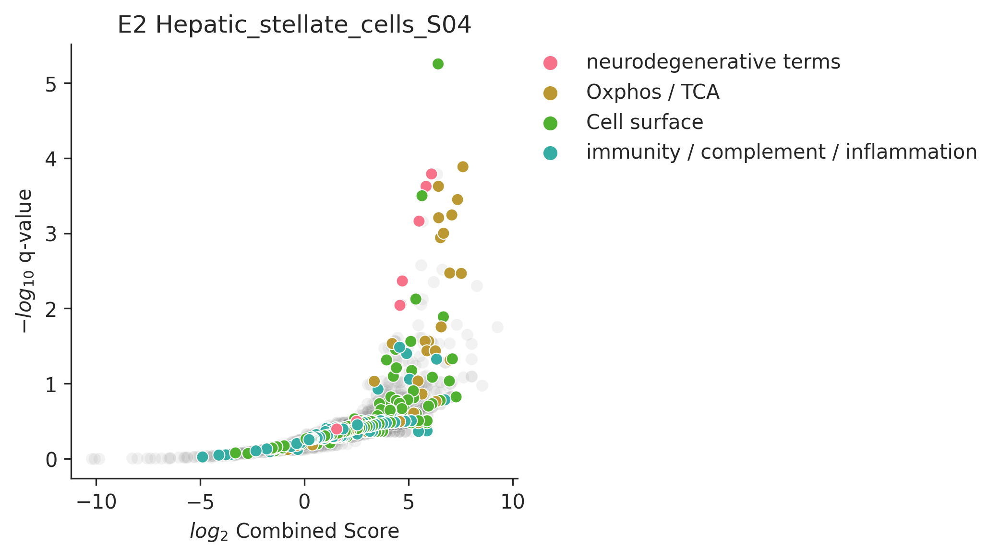

In [17]:
visualise.backend = "matplotlib"
fig = hepatic_stellate_cells_s04_scatter.highlight(  

    ref_col = "Term", subsets = categories, 
    xlabel = xlabel(), ylabel = ylabel(),
    title = "E2 Hepatic_stellate_cells_S04",

)
sns.despine()
plt.savefig( f"{outdir}/E2_Hepatic_stellate_cells_S04.png", bbox_inches = "tight", facecolor = None )

### Mast_cells_S01

In [ ]:
mast_cells_s01_df = get_celltype_df( "E2", "Mast_cells_S01" )
mast_cells_s01_scatter = visualise.StateScatterplot( df = mast_cells_s01_df, x = x, y = y, hue = hue, style = style )

Categories to highlight in Mast_cells_S01

In [ ]:
categories = {
	"lipid associated" : ["lipid", "lipo(protein)?", "triacyl", "lipase", "acylglycer", "triglycer", "chylomicron", "fat", "fatty ?-?_?acid", "L( |_|-)?DL", "H( |_|-)?DL", "V( |_|-)?LDL", "PPAR"],
	"cytokine / chemokine related" : ["cytokine", "chemokine"],
	"Interleukin" : ["interleukin", "IL- "],
	"Membrane associated" : ["membrane"],
	"immunity / complement / inflammation" : ["immune response", "immune", "immunity", "inflamma", "complement", "B-? ?cell", "T-? ?cell", "lymphocyte", "lymph(atic|oid) cell"],
	"RNA metabolism" : ["m?RNA", "transcription", "NMD", "nonsense ?-?mediated"],
	"amino acids" : ["valine", "leucine", "isoleucine", "methionine", "glutamine", "glutamate", "asparagine", "aspartate", "proline", "lysine", "tryptophane", "tyrosine", "arginine", "histidine", "serine", "glycine", "alanine", "threonine", "cysteine", "phenylalanine", "amino-?_?acid"]
	}

Interactive scatterplot

In [ ]:
visualise.backend = "plotly"
fig = mast_cells_s01_scatter.highlight(  

    ref_col = "Term", subsets = categories, 
    xlabel = xlabel(), ylabel = ylabel(),
    title = "E2 Mast_cells_S01",
    hover_data = { "Combined Score" : "Combined Score", "Genes": "Genes" },

)
fig.show()

In [ ]:
# fig.write_html( f"{outdir}/E2_Mast_cells_S01.html" )

Static scatterplot

In [ ]:
# visualise.backend = "matplotlib"
# fig = mast_cells_s01_scatter.highlight(  
#
#     ref_col = "Term", subsets = categories, 
#     xlabel = xlabel(), ylabel = ylabel(),
#     title = "E2 Mast_cells_S01",
#
# )
# sns.despine()
# plt.savefig( f"{outdir}/E2_Mast_cells_S01.png", bbox_inches = "tight" )

### Unknown_S03

In [ ]:
unknown_s03_df = get_celltype_df( "E2", "Unknown_S03" )
unknown_s03_scatter = visualise.StateScatterplot( df = unknown_s03_df, x = x, y = y, hue = hue, style = style )

Categories to highlight in Unknown_S03

In [ ]:
categories = {
	"Interleukin" : ["interleukin", "IL- "],
	"Apoptosis" : ["apoptosis", "apopto"],
	"Membrane associated" : ["membrane"],
	"Cell surface" : ["cell ?-?surface", "cell ?-?periphery", "cell ?-?membrane", "cell ?-?junction", "plasma ?-?membrane", "integrin", "adhesion", "cell-cell", "cadherin"],
	"cell structures" : ["actin", "fibr", "cyto ?-?skelet", "envel", "tubulin"],
	"immunity / complement / inflammation" : ["immune response", "immune", "immunity", "inflamma", "complement", "B-? ?cell", "T-? ?cell", "lymphocyte", "lymph(atic|oid) cell"],
	"translation" : ["translation", "rRNA", "ribosom", "peptide chain", "elongation", "initiation", "termination"],
	"RNA metabolism" : ["m?RNA", "transcription", "NMD", "nonsense ?-?mediated"],
	"amino acids" : ["valine", "leucine", "isoleucine", "methionine", "glutamine", "glutamate", "asparagine", "aspartate", "proline", "lysine", "tryptophane", "tyrosine", "arginine", "histidine", "serine", "glycine", "alanine", "threonine", "cysteine", "phenylalanine", "amino-?_?acid"]
	}

Interactive scatterplot

In [ ]:
visualise.backend = "plotly"
fig = unknown_s03_scatter.highlight(  

    ref_col = "Term", subsets = categories, 
    xlabel = xlabel(), ylabel = ylabel(),
    title = "E2 Unknown_S03",
    hover_data = { "Combined Score" : "Combined Score", "Genes": "Genes" },

)
fig.show()

In [ ]:
# fig.write_html( f"{outdir}/E2_Unknown_S03.html" )

Static scatterplot

In [ ]:
# visualise.backend = "matplotlib"
# fig = unknown_s03_scatter.highlight(  
#
#     ref_col = "Term", subsets = categories, 
#     xlabel = xlabel(), ylabel = ylabel(),
#     title = "E2 Unknown_S03",
#
# )
# sns.despine()
# plt.savefig( f"{outdir}/E2_Unknown_S03.png", bbox_inches = "tight" )